In [1]:
import json 
import os
import numpy as np

Вот так выглядит молекула в Discovery Studio. Сохраним в формате json и обработаем с помощью Python.

![title](TestMoleculaFormat\cancer_mol.png)

In [63]:
filepath = os.path.join('TestMoleculaFormat' , 'cancer_mol.json')

with open(filepath, 'r') as j:
    json_data = json.load(j)

In [64]:
json_data.keys() , json_data['meshes'][0].keys()

(dict_keys(['opaqueSpheres', 'cylinders', 'meshes', 'graphicsAttributes']),
 dict_keys(['vertices', 'normals', 'colors', 'indices', 'alpha', 'doubleSide', 'ids']))

In [65]:
vertices  = np.array(json_data['meshes'][0]['vertices']).reshape((-1,3)) #считали вершины 
triang_ind = np.array(json_data['meshes'][0]['indices']).reshape((-1,3)) #считали индексы вершин треугольников 
normals =  np.array(json_data['meshes'][0]['normals']).reshape((-1,3)) #считали векторы нормалей 
colors =  np.array(json_data['meshes'][0]['colors']).reshape((-1,3)) # считали цвета вершин 

In [66]:
vertices.shape , triang_ind.shape , normals.shape , colors.shape

((8204, 3), (16404, 3), (8204, 3), (8204, 3))

In [67]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [68]:
rand_vector = np.random.randint(0,normals.shape[0] , 500)

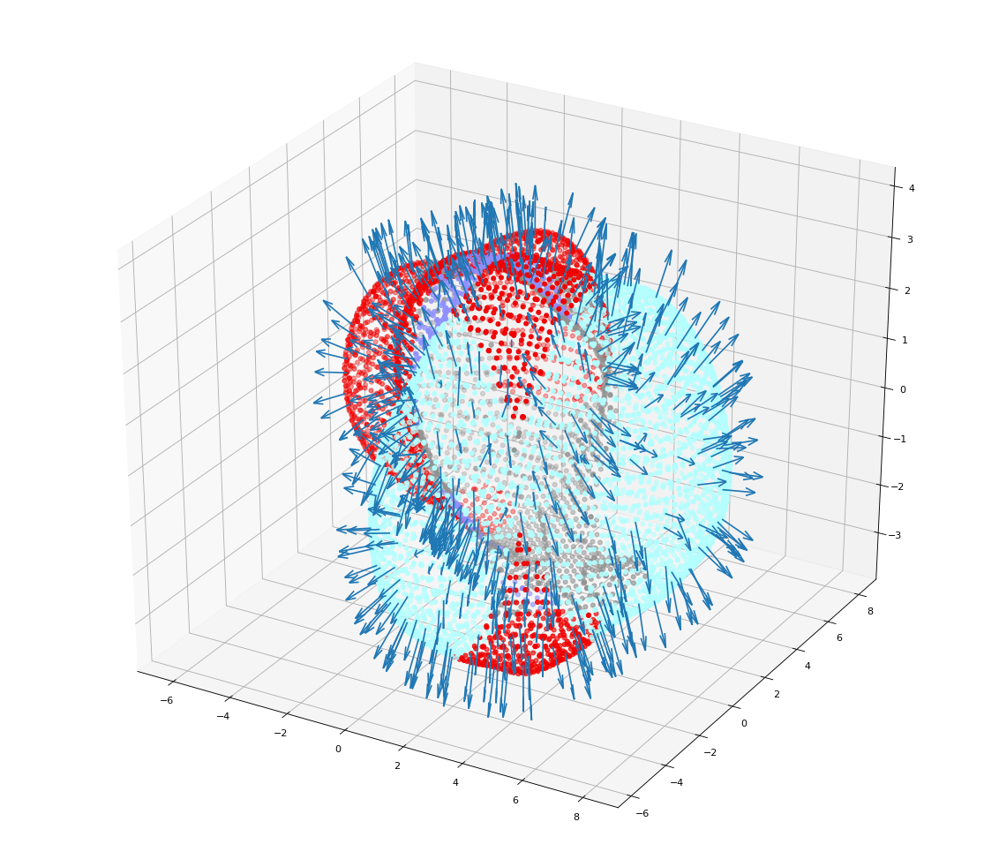

In [69]:
fig= plt.figure(figsize=(18, 16), dpi= 80, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111, projection='3d')
ax.scatter(vertices[:,0],vertices[:,1],vertices[:,2] , color = colors)
ax.quiver(vertices[rand_vector,0],vertices[rand_vector,1],vertices[rand_vector,2],
          normals[rand_vector,0] , normals[rand_vector,1] ,normals[rand_vector,2]  )

In [59]:
def triang_colors(colors , triang_ind):
    return [tuple(np.mean(colors[triang] , axis = 0)) for triang in triang_ind]

In [70]:
import plotly.figure_factory as ff
from plotly.offline import iplot
import plotly

fig = ff.create_trisurf(vertices[:,0],vertices[:,1],vertices[:,2],
                         color_func = triang_colors(colors , triang_ind),
                         simplices=triang_ind,
                         title="Molecula")
fig.show()

In [72]:
center = vertices.mean(axis = 0)

In [85]:
vectors = np.array(list(map(lambda x: x / np.linalg.norm(x) ,vertices - center)))

In [89]:
R = 20

fig = ff.create_trisurf(R*vectors[:,0],R*vectors[:,1],R*vectors[:,2],
                         color_func = triang_colors(colors , triang_ind),
                         simplices=triang_ind,
                         title="Sphere aproximation")
fig.show()



In [91]:
plot_data = []

mol = ff.create_trisurf(vertices[:,0],vertices[:,1],vertices[:,2],
                         color_func = triang_colors(colors , triang_ind),
                         simplices=triang_ind,
                         title="Molecula") 

print(mol['data'])

(Mesh3d({
    'facecolor': array(['rgb(240, 0, 0)', 'rgb(240, 0, 0)', 'rgb(240, 0, 0)', ...,
                        'rgb(240, 0, 0)', 'rgb(240, 0, 0)', 'rgb(240, 0, 0)'], dtype=object),
    'i': array([   2,    4,    3, ..., 8203, 8161, 8142]),
    'j': array([   1,    3,    2, ..., 8161, 8159, 8161]),
    'k': array([   0,    0,    0, ..., 8202, 8202, 8203]),
    'name': '',
    'x': array([3.34 , 3.117, 3.34 , ..., 1.803, 2.059, 2.315]),
    'y': array([-2.424, -2.424, -2.628, ...,  0.395,  0.395,  0.395]),
    'z': array([-3.452, -3.433, -3.433, ...,  3.774,  3.776,  3.754])
}), Scatter3d({
    'line': {'color': 'rgb(50, 50, 50)', 'width': 1.5},
    'mode': 'lines',
    'showlegend': False,
    'x': array([3.34, 3.117, 3.34, ..., 2.315, 2.387, None], dtype=object),
    'y': array([-2.628, -2.424, -2.424, ..., 0.395, 0.395, None], dtype=object),
    'z': array([-3.433, -3.433, -3.452, ..., 3.754, 3.741, None], dtype=object)
}))


In [92]:
plot_data.append(mol)

for i in range(3):
    trace = ff.create_trisurf(vertices[:,0],vertices[:,1],vertices[:,2],
                         color_func = triang_colors(colors , triang_ind),
                         simplices=triang_ind,
                         title="Molecula") 
    plot_data.append(trace)

steps = list()

for i in range(3):
        step = dict(
        method='restyle',
        args=['visible', [False] * (4)],
        label='Time Step {}'.format(i)
        )
        step['args'][1][i] = True
        steps.append(step)

sliders = [dict(steps=steps)]

layout=dict(sliders=sliders)

fig=dict(data=mol,layout=layout)
plotly.offline.plot(fig,validate=False)

'temp-plot.html'